# Creating a basketball mini map using homography transformations

Author Stephan Janssen (sja@devoxx.com)

See also related [article on LinkedIn](https://www.linkedin.com/pulse/journey-towards-creating-basketball-mini-map-stephan-janssen/) and result on [YouTube](https://www.youtube.com/watch?v=tpavRDeDlTI).

We still need to identify the players per team which can be achieved using colour detection, that's not too difficult.

Improvements or suggestions are always welcome!

# Install detectron2

In [ ]:
# install dependencies
!pip install -U torch torchvision cython
!pip install -U 'git+https://github.com/facebookresearch/fvcore.git' 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
torch.__version__

Requirement already up-to-date: torch in /usr/local/lib/python3.6/dist-packages (1.5.1+cu101)
Requirement already up-to-date: torchvision in /usr/local/lib/python3.6/dist-packages (0.6.1+cu101)
     |████████████████████████████████| 2.0MB 23.9MB/s 
  Found existing installation: Cython 0.29.20
    Uninstalling Cython-0.29.20:
      Successfully uninstalled Cython-0.29.20
  Cloning https://github.com/facebookresearch/fvcore.git to /tmp/pip-req-build-d9y8va4j
  Running command git clone -q https://github.com/facebookresearch/fvcore.git /tmp/pip-req-build-d9y8va4j
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-cb69yugb
  Running command git clone -q https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-cb69yugb
     |████████████████████████████████| 276kB 11.0MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.1-cp36-none-any.whl size=45766 sha256=0a75152adcf469c5d41831aeb9e4acca549502575a658834880f636fe04b9b8c
  Stored in directory: /tmp/pip-ephem-

'1.5.1+cu101'

In [ ]:
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo
!pip install -e detectron2_repo

Cloning into 'detectron2_repo'...
remote: Enumerating objects: 28, done.
remote: Counting objects: 100% (28/28), done.
remote: Compressing objects: 100% (25/25), done.
remote: Total 5963 (delta 5), reused 11 (delta 3), pack-reused 5935
Receiving objects: 100% (5963/5963), 2.75 MiB | 1.84 MiB/s, done.
Resolving deltas: 100% (4311/4311), done.
Obtaining file:///content/detectron2_repo
  Created wheel for pycocotools: filename=pycocotools-2.0.1-cp36-cp36m-linux_x86_64.whl size=266507 sha256=8c9425c76dc7d94a3f176eb4d95e8451a035be4e906b8cccf15073d7fb509bf9
  Stored in directory: /root/.cache/pip/wheels/86/19/08/49b25f258ead1f861c9ab2fc41f73636f2928859adbb0e9797
Successfully built pycocotools
  Found existing installation: pycocotools 2.0
    Uninstalling pycocotools-2.0:
      Successfully uninstalled pycocotools-2.0
  Running setup.py develop for detectron2


In [ ]:
# You may need to restart your runtime prior to this, to let your installation take effect

# Some basic setup

# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

# Run a pre-trained detectron2 model

We first download a random image from the COCO dataset:

In [ ]:
%ls

basketball.jpg  detectron2_repo/  sample_data/            tennis_play_1.mp4
basketball.png  player_box.mp4    tennis_homographic.mp4
court.jpg       result_video.mp4  tennis.jpg


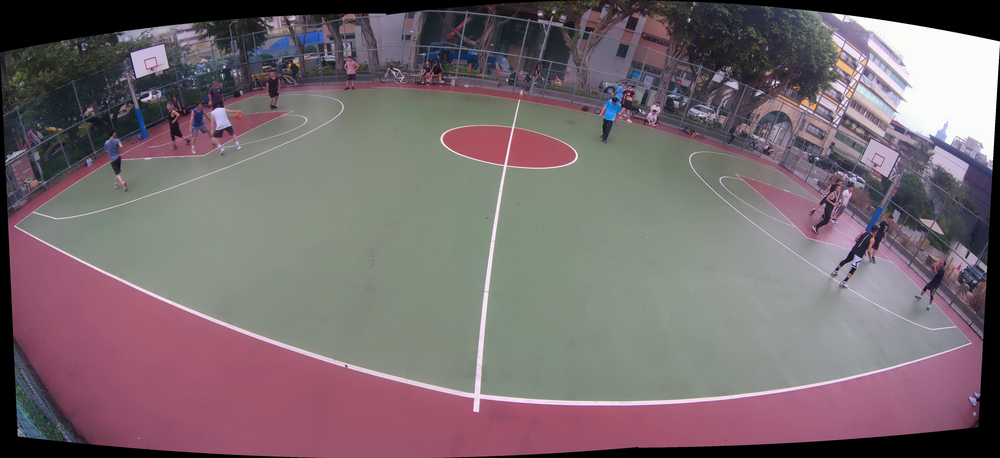

In [ ]:
# !wget https://basketball-ml.s3-eu-west-1.amazonaws.com/3DVideoFrame.jpg -O input.jpg
im = cv2.imread("./basketball.png")
cv2_imshow(im)


Then, we create a detectron2 config and a detectron2 `DefaultPredictor` to run inference on this image.

In [ ]:
cfg = get_cfg()

cfg.merge_from_file("./detectron2_repo/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")

cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model

cfg.MODEL.WEIGHTS = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl"

predictor = DefaultPredictor(cfg)

players_output = predictor(im)

model_final_f10217.pkl: 178MB [00:17, 10.4MB/s]                           


In [ ]:
# look at the outputs. See https://detectron2.readthedocs.io/tutorials/models.html#model-output-format for specification
instances = players_output["instances"]
print(instances)
pred_boxes = instances.get("pred_boxes")
pred_classes = instances.get("pred_classes")
print(pred_boxes)
print(pred_classes)

Instances(num_instances=23, image_height=2136, image_width=4662, fields=[pred_boxes: Boxes(tensor([[ 486.1224,  604.9347,  598.4943,  894.4645],
        [4280.5332, 1200.9016, 4412.2686, 1433.8027],
        [ 965.1938,  429.8839, 1126.7909,  713.2786],
        [2793.1809,  409.7443, 2906.4695,  667.4793],
        [1597.2876,  250.7832, 1674.4968,  419.6509],
        [3789.7603,  823.9653, 3930.2136, 1076.3406],
        [3871.7834, 1064.2296, 4100.3628, 1330.3494],
        [1758.7756,  300.8257, 1899.6227,  389.7393],
        [1240.0709,  314.8993, 1307.0334,  508.1841],
        [ 771.4202,  449.3254,  861.3610,  686.8913],
        [ 884.1555,  473.7047,  985.0646,  722.3303],
        [1346.3351,  275.8729, 1400.7347,  396.0778],
        [3009.8591,  484.8491, 3079.3833,  586.5192],
        [3210.2847,  487.6417, 3326.1250,  566.2862],
        [3869.9470,  857.8189, 3981.4702, 1035.7892],
        [4433.4204, 1221.3051, 4588.5664, 1488.7015],
        [ 115.7012,  576.9421,  221.6851,  85

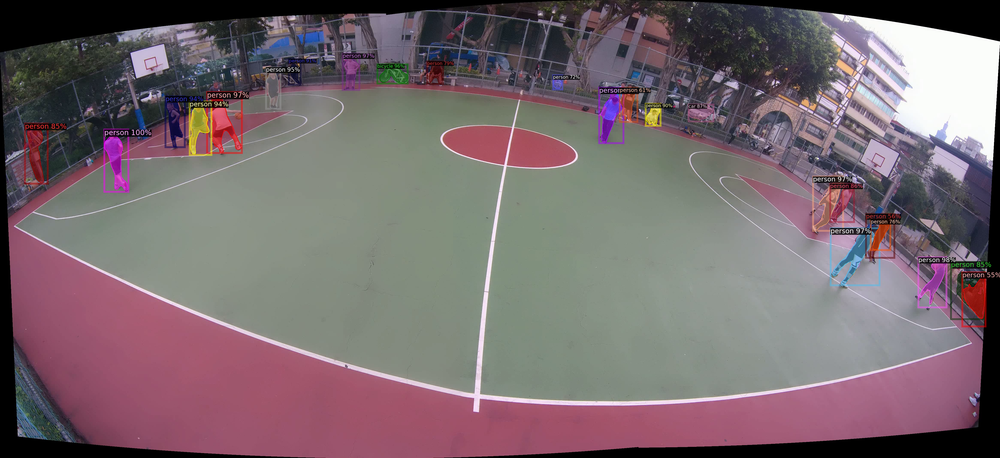

In [ ]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.0)
v = v.draw_instance_predictions(players_output["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

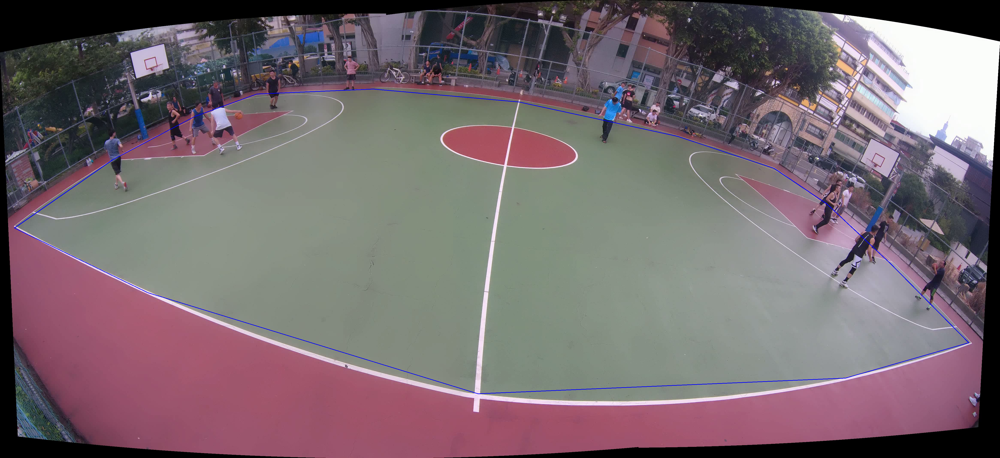

In [ ]:
# Four corners of the 3D court 
# Start top-left corner and go anti-clock wise
src_pts = np.array(
        [[  67, 1063],
 [ 526,  744],
 [ 909,  542],
 [1197,  438],
 [1740,  415],
 [2418,  475],
 [3157,  635],
 [3609,  785],
 [3855,  951],
 [4148, 1226],
 [4516, 1598],
 [3941, 1763],
 [2228, 1836],
 [ 690, 1365]]
    )   

im_poly = im.copy()

# cv2.fillPoly(img_src, [src_pts], 255)
cv2.polylines(im_poly, [src_pts], isClosed=True, color=[255,0,0], thickness=2)

cv2_imshow(im_poly)

[ 542,  894]
[ 4346,  1433]
[ 1045,  713]
[ 2849,  667]
[ 1635,  419]
[ 3859,  1076]
[ 3985,  1330]


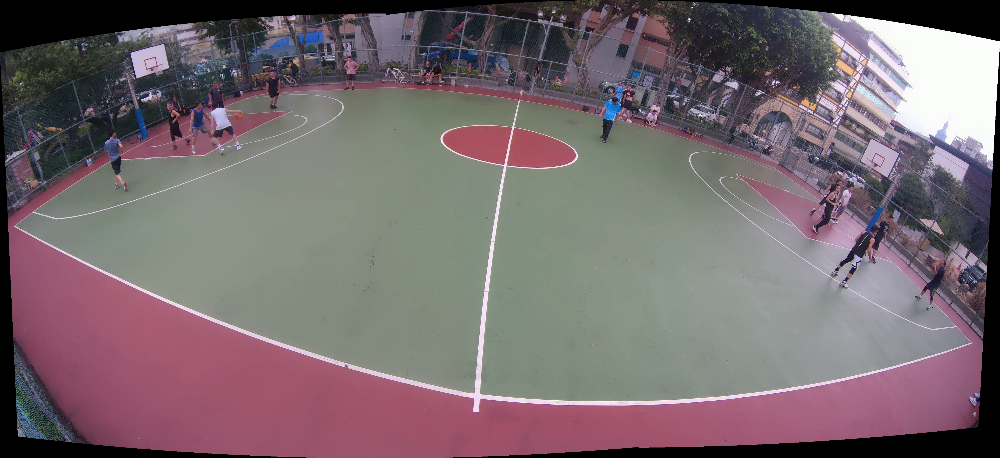

In [ ]:
# Use the boxes info from the tensor prediction result
# #
# x1,y1 ------
# |          |
# |          |
# |          |
# --------x2,y2
#
from shapely.geometry import Point, Polygon

def drawPlayers(im, pred_boxes, showResult=False):
  color = [255, 0, 0]   
  thickness = 1
  radius = 1

  i  = 0
  for box in pred_boxes:
    
    # Include only class Person
    if pred_classes[i] == 0:  
        
      x1 = int(box[0])
      y1 = int(box[1])
      x2 = int(box[2])
      y2 = int(box[3])

      xc = x1 + int((x2 - x1)/2)
      player_pos1 = (xc - 1, y2)
      player_pos2 = (xc + 1, y2 + 1)

      court = Polygon(src_pts)

      # Draw only players that are within the basketball court
      if Point(player_pos1).within(court):
        if showResult:
          print("[% 3d, % 3d]" %(xc, y2))

      cv2.rectangle(im, player_pos1, player_pos2, color, thickness)
      i = i + 1            

  if showResult:
    cv2_imshow(im)


drawPlayers(im, pred_boxes, True)

In [ ]:
!wget https://basketball-ml.s3-eu-west-1.amazonaws.com/2DCourt1920x1080.jpg -O court.jpg

--2020-07-08 03:43:56--  https://basketball-ml.s3-eu-west-1.amazonaws.com/2DCourt1920x1080.jpg
Resolving basketball-ml.s3-eu-west-1.amazonaws.com (basketball-ml.s3-eu-west-1.amazonaws.com)... 52.218.104.171
Connecting to basketball-ml.s3-eu-west-1.amazonaws.com (basketball-ml.s3-eu-west-1.amazonaws.com)|52.218.104.171|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 141081 (138K) [image/jpeg]
Saving to: ‘court.jpg’

court.jpg           100%[===================>] 137.77K   159KB/s    in 0.9s    

2020-07-08 03:43:58 (159 KB/s) - ‘court.jpg’ saved [141081/141081]



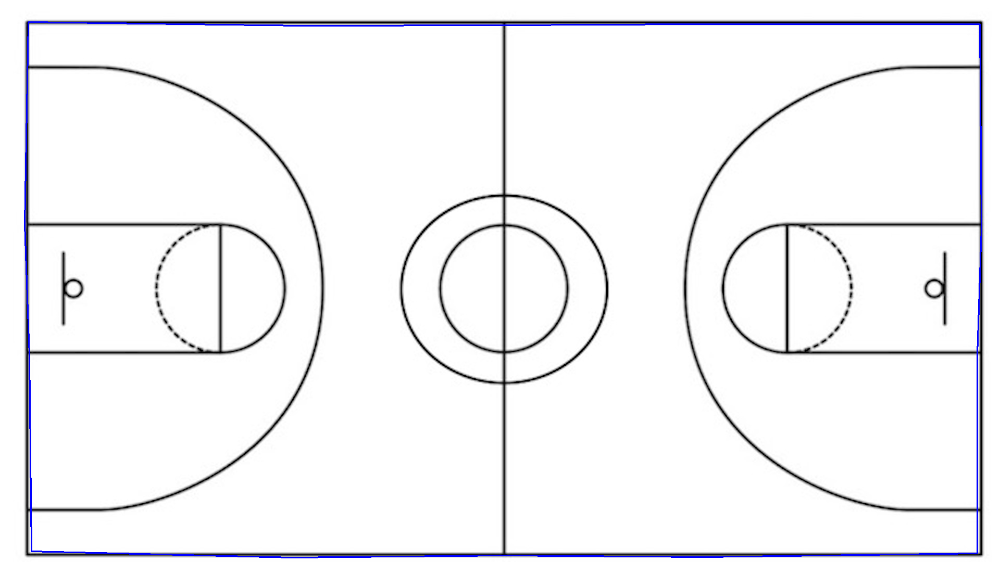

In [ ]:
img_dst = cv2.imread('./court.png')

# Four corners of the court + mid-court circle point in destination image 
# Start top-left corner and go anti-clock wise + mid-court circle point
# dst_pts = np.array([
#       [144,  1060],  # LEFT BOTTOM
#       [969,  1065],  # MIDDLE BOTTOM
#       [1769, 1063],  # RIGHT BOTTOM
#       [1885, 875],   # TOP BOTTOM RIGHT  (4 o'clock)
#       [1882,  49],   # TOP RIGHT
#       [50,    43],   # TOP LEFT
#       [50,    871]   # TOP - BOTTOM LEFT (7 o'clock)
#     ])   
dst_pts = np.array(
    [[  60, 1059],
 [  56,  682],
 [  47,  431],
 [  54,   42],
 [ 581,   49],
 [ 967 ,  48],
 [1329 ,  46],
 [1881 ,  46],
 [1884 , 438],
 [1876,  680],
 [1876, 1063],
 [1351, 1070],
 [ 967, 1067],
 [ 559, 1071]])
cv2.polylines(img_dst, [dst_pts], isClosed=True, color=[255,0,0], thickness=2)
cv2_imshow(img_dst)

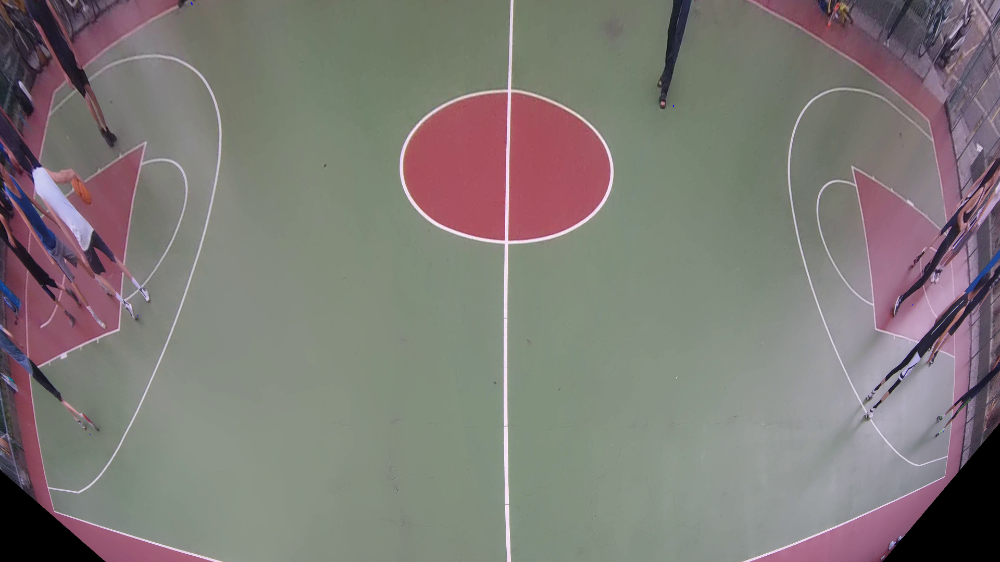

In [ ]:
def homographyTransform(im, showResult=False):

  # Calculate Homography
  h, status = cv2.findHomography(src_pts, dst_pts)
  img_out = cv2.warpPerspective(im, h, (img_dst.shape[1], img_dst.shape[0]))
  
  if showResult:
    cv2_imshow(img_out)

  return img_out  

# Try out
img_out = homographyTransform(im, True)  

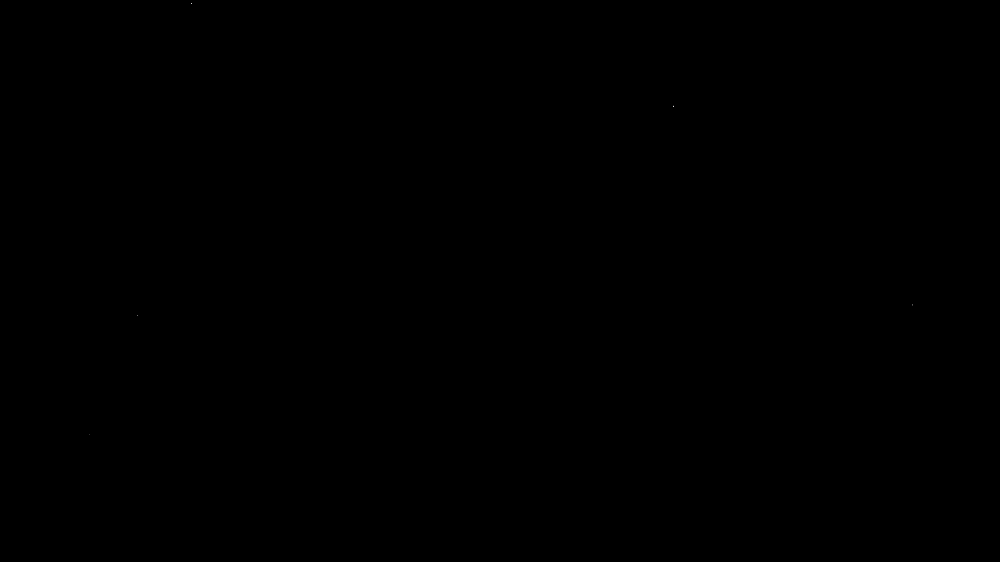

In [ ]:
def getPlayersMask(im):
  lower_range = np.array([255,0,0])                         # Set the Lower range value of blue in BGR
  upper_range = np.array([255,155,155])                     # Set the Upper range value of blue in BGR
  mask = cv2.inRange(im, lower_range, upper_range)     # Create a mask with range
  result = cv2.bitwise_and(im, img_out, mask = mask)   # Performing bitwise and operation with mask in img variable
  # cv2_imshow(result)                              

  return cv2.inRange(result, lower_range, upper_range)  
  
# Try out  
mask = getPlayersMask(img_out)    
cv2_imshow(mask)

In [ ]:
def drawPlayersOnCourt(im, coord, color, radius=10):
  # print(coord)
  for pos in coord:
    center_coordinates = (pos[0], pos[1])
    cv2.circle(im, center_coordinates, radius, color, thickness=-1) 
  return im

Now lets create a mini-map based on a 30 seconds basketball game.

In [ ]:
!wget https://basketball-ml.s3-eu-west-1.amazonaws.com/mini-map-game-input.mp4 -O video.mp4

In [ ]:
# Draft method to draw lines between history player positions to show trail
def drawCoordinateLines(result, pts, currentFrame, player):
  
  for i in np.arange(1, len(pts)):
    
    # if either of the tracked points are None, ignore them
    if pts[i - 1] is None or pts[i] is None:
      continue

    thickness = int(np.sqrt(30 / float(i + 1)) * 2.5)
    print("player=%s" %player)
    x1 = pts[i - 1][0][0]
    x2 = pts[i - 1][0][1]
    print("x1=%d, x2=%d" %(x1, x2))
    y1 = pts[i][0][0]
    y2 = pts[i][0][1]
    print("y1=%d, y2=%d" %(y1, y2))
    print(" ---------------------- ")
    cv2.line(result, (x1, x2), (y1, y2), red_color, thickness)

  return result

In [ ]:
import time
import progressbar
from time import sleep
from collections import deque
from detectron2.utils.visualizer import ColorMode
from detectron2.utils.visualizer import GenericMask
import imutils

vs = cv2.VideoCapture("./result_video.mp4")
totalFrames = int(vs.get(cv2.CAP_PROP_FRAME_COUNT))

grabbed = True
currentFrame = 0
start = time.time()
writer = None
box_writer = None

bar = progressbar.ProgressBar(maxval=totalFrames, \
      widgets=[progressbar.Bar('=', '[', ']'), ' ', progressbar.Percentage()])

bar.start()

court_img = cv2.imread('./court.png')

blue_color = (255,0,0)
red_color = (0,0,255)

# loop over frames from the video file stream (207)
while grabbed:     
  # read the next frame from the file
  (grabbed, frame) = vs.read()
  
  if writer is None and box_writer is None:
    fps = vs.get(cv2.CAP_PROP_FPS)
    fourcc = cv2.VideoWriter_fourcc(*"mp4v")
    writer = cv2.VideoWriter("tennis_homographic.mp4", fourcc, fps, (court_img.shape[1], court_img.shape[0]), True)
    box_writer = cv2.VideoWriter("player_box.mp4",fourcc,fps,(im.shape[1],im.shape[0]),True)
  if grabbed:
    # print(currentFrame)
    players_output = predictor(frame)# predict on frame
    # Get player positions
    outputs = predictor(frame)  
    instances = outputs["instances"].to("cpu")
    boxes = instances.get("pred_boxes")

    v = Visualizer(frame[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.0)
    v = v.draw_instance_predictions(players_output["instances"].to("cpu"))
 
    court = court_img.copy()

    # Draw players on video frame
    drawPlayers(frame, boxes, False)
    
    img_out = homographyTransform(frame, False)
    # cv2_imshow(img_out)

    mask = getPlayersMask(img_out)
    
    # cv2_imshow(mask)

    # Get the contours from the players "dots" so we can reduce the coordinates
    # to the number of players on the court.
    cnts = cv2.findContours(mask.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)

    if cnts is not None:  
      # print(cnts)   
      for cnt in cnts:
        result = drawPlayersOnCourt(court, cnt[0], blue_color)
                               
      writer.write(result)
      box_writer.write(v.get_image()[:, :, ::-1])

    currentFrame += 1
    bar.update(currentFrame)
  
  else:
      grabbed = False

# cv2_imshow(result)
    
writer.release()
box_writer.release()
vs.release()
bar.finish()

end = time.time()
elap = (end - start)
print("[INFO] process took {:.4f} seconds".format(elap))

print("Video created")

[========================================================================] 100%


[INFO] process took 846.2020 seconds
Video created
